# Figure 3: Mask Before and After Head Addition

Text(value='', placeholder='Enter path to first .nii.gz file')

Text(value='', placeholder='Enter path to second .nii.gz file')

Button(description='Show Slice', style=ButtonStyle())

Displaying slice 81 with the most nonzero pixels


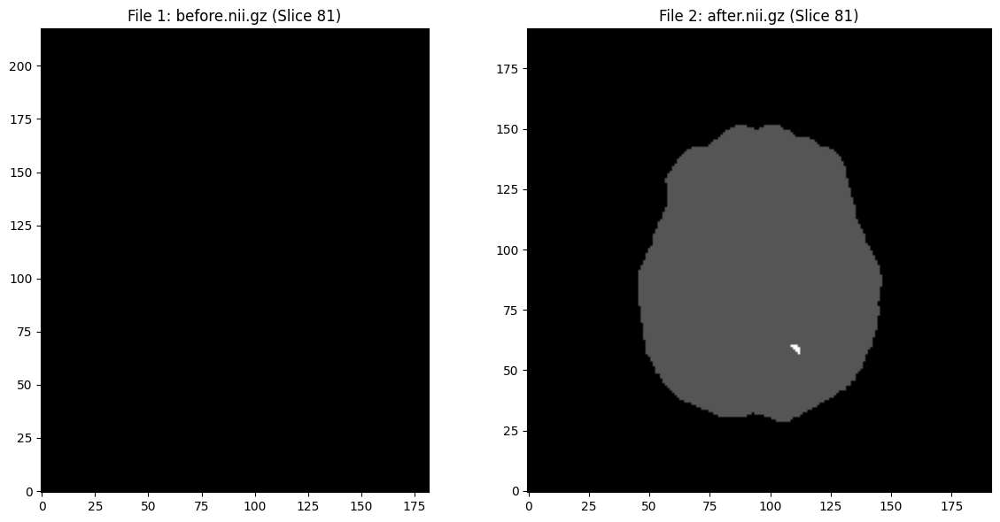

In [2]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display
from pathlib import Path
import random

# Function to find a few random slices
def find_random_slices(data1, data2, num_slices=3):
    n_slices = min(data1.shape[2], data2.shape[2])  # Ensure we don't exceed the smallest number of slices
    return random.sample(range(n_slices), num_slices)

# Function to display random slices
def display_slices(file1, file2):
    if not Path(file1).exists() or not Path(file2).exists():
        print("Error: One or both files do not exist.")
        return
    
    # Load images
    img1, img2 = nib.load(file1), nib.load(file2)
    data1, data2 = img1.get_fdata(), img2.get_fdata()

    # Find random slices
    slice_indices = find_random_slices(data1, data2)
    print(f"Displaying slices {slice_indices}")

    # Plot the slices side by side
    fig, axes = plt.subplots(len(slice_indices), 2, figsize=(12, 6 * len(slice_indices)))
    for i, slice_idx in enumerate(slice_indices):
        axes[i, 0].imshow(data1[:, :, slice_idx].T, cmap="gray", origin="lower")
        axes[i, 0].set_title(f"File 1: {Path(file1).name} (Slice {slice_idx})")
        axes[i, 1].imshow(data2[:, :, slice_idx].T, cmap="gray", origin="lower")
        axes[i, 1].set_title(f"File 2: {Path(file2).name} (Slice {slice_idx})")
    plt.tight_layout()
    plt.show()

# File selectors for Jupyter
file1_widget = widgets.Text(placeholder="Enter path to first .nii.gz file")
file2_widget = widgets.Text(placeholder="Enter path to second .nii.gz file")
button = widgets.Button(description="Show Slice")

def on_button_click(b):
    display_slices(file1_widget.value, file2_widget.value)

button.on_click(on_button_click)

display(file1_widget, file2_widget, button)

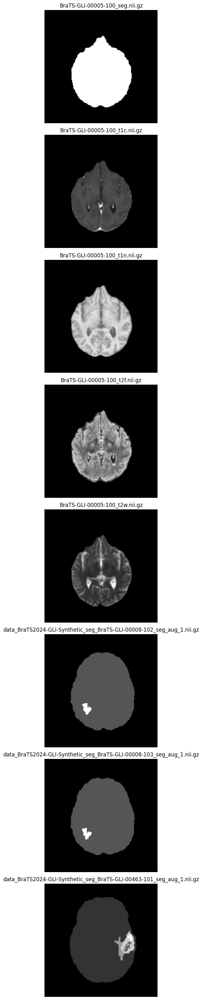

In [3]:
import os
import glob
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np

# Set the folder path containing the nii.gz files
folder_path = 'example'
file_pattern = os.path.join(folder_path, '*.nii.gz')
nii_files = sorted(glob.glob(file_pattern))

# Number of files found
n_files = len(nii_files)
if n_files == 0:
    raise FileNotFoundError("No nii.gz files found in the specified folder.")

# Define the noise level (standard deviation of the Gaussian noise)
noise_std = 0.0

# Create vertical subplots to display each noisy slice stacked
fig, axes = plt.subplots(n_files, 1, figsize=(6, 4 * n_files))

# Ensure axes is a list even if there's only one file
if n_files == 1:
    axes = [axes]

for ax, file in zip(axes, nii_files):
    # Load the image and extract the data
    img = nib.load(file)
    data = img.get_fdata()

    # Extract the middle slice along the z-axis
    mid_slice = data.shape[2] // 2
    slice_data = data[:, :, mid_slice]

    # Add Gaussian noise to the slice
    noise = np.random.normal(0, noise_std, slice_data.shape)
    slice_data_noisy = slice_data + noise

    # Display the noisy slice
    ax.imshow(slice_data_noisy.T, cmap='gray', origin='lower')
    ax.set_title(os.path.basename(file))
    ax.axis('off')

plt.tight_layout()
plt.show()

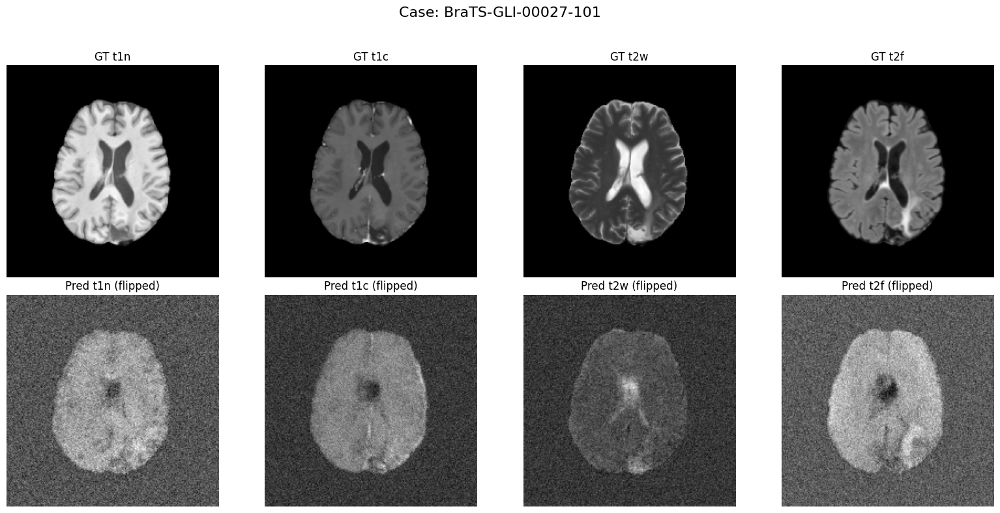

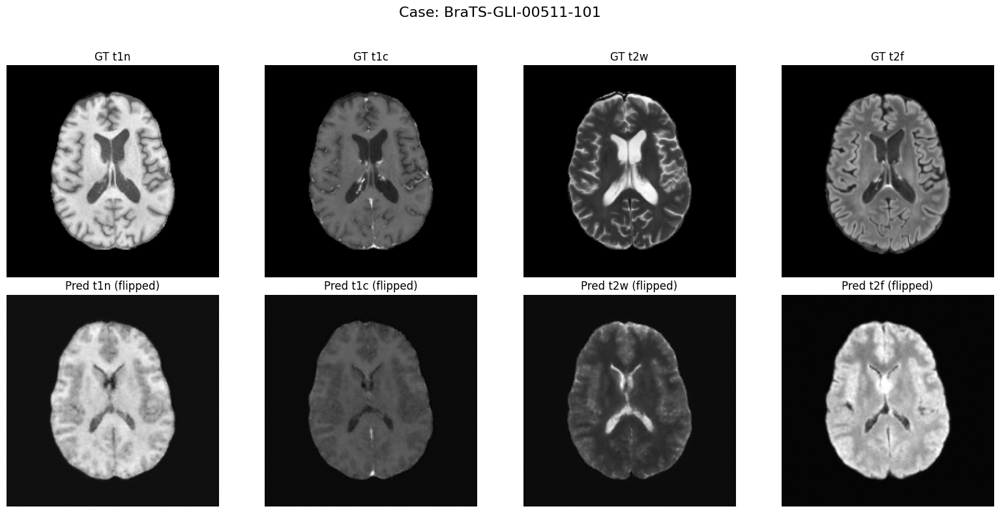

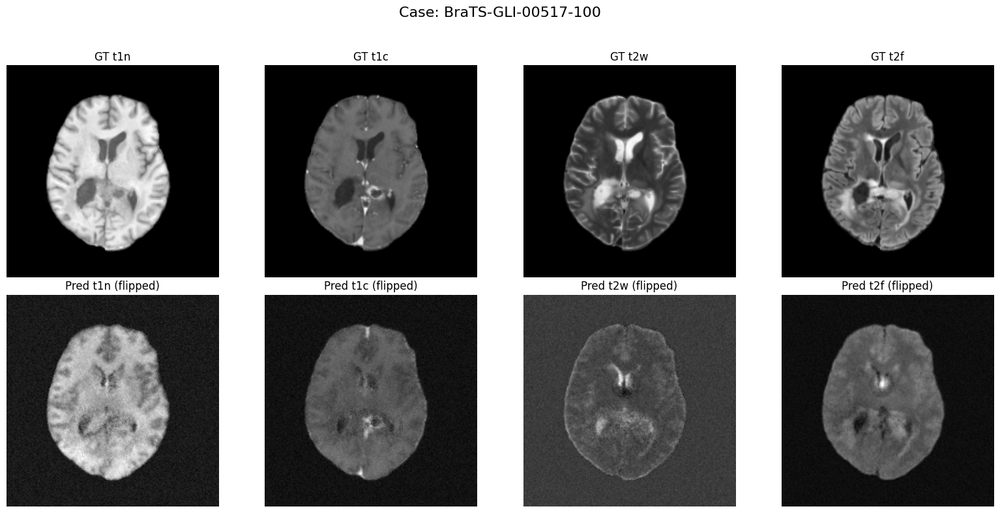

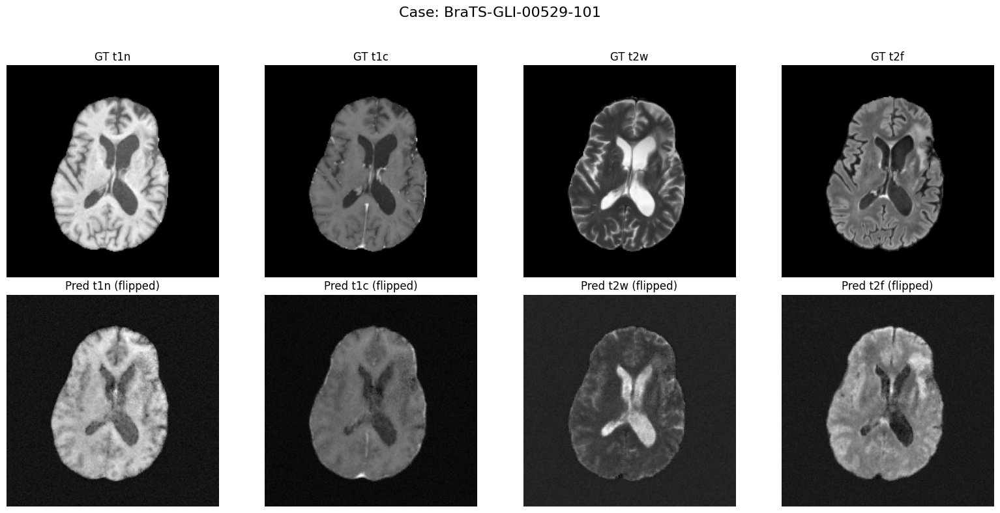

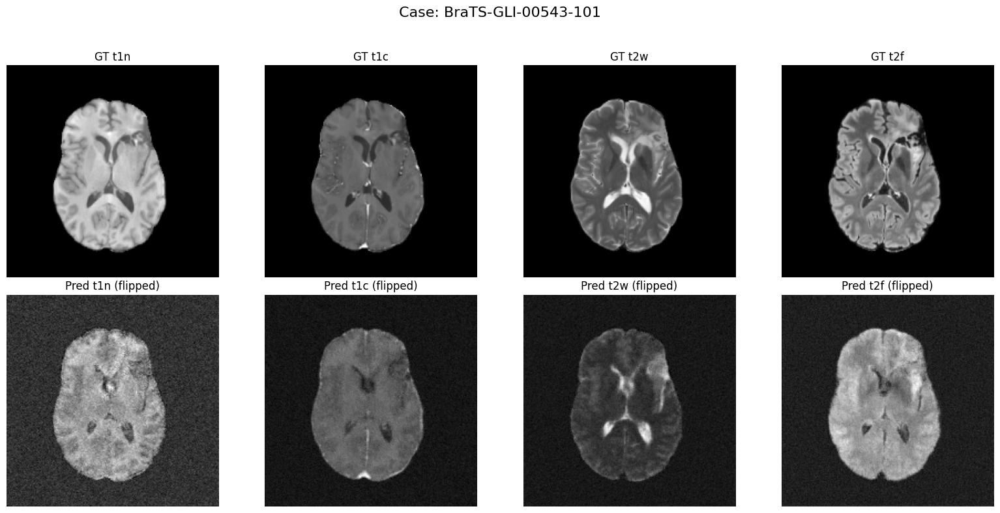

...

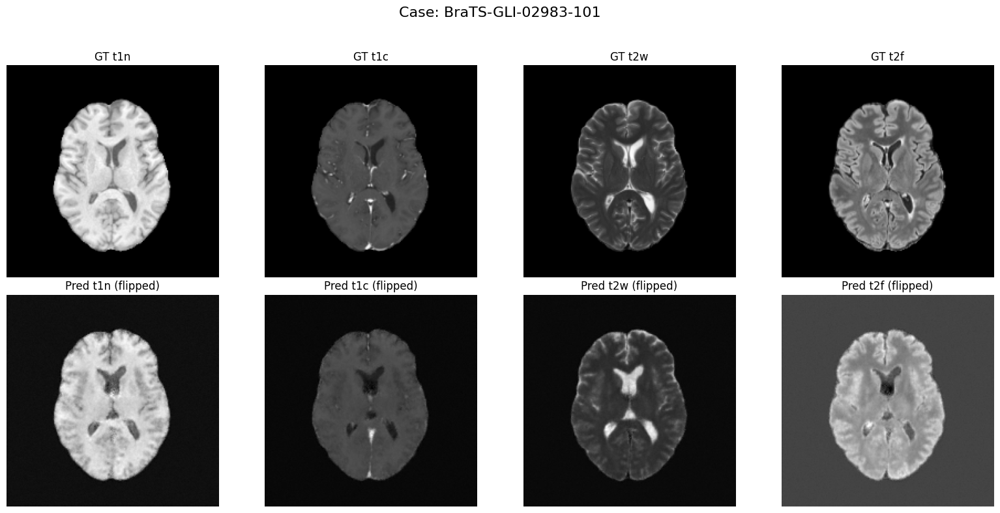

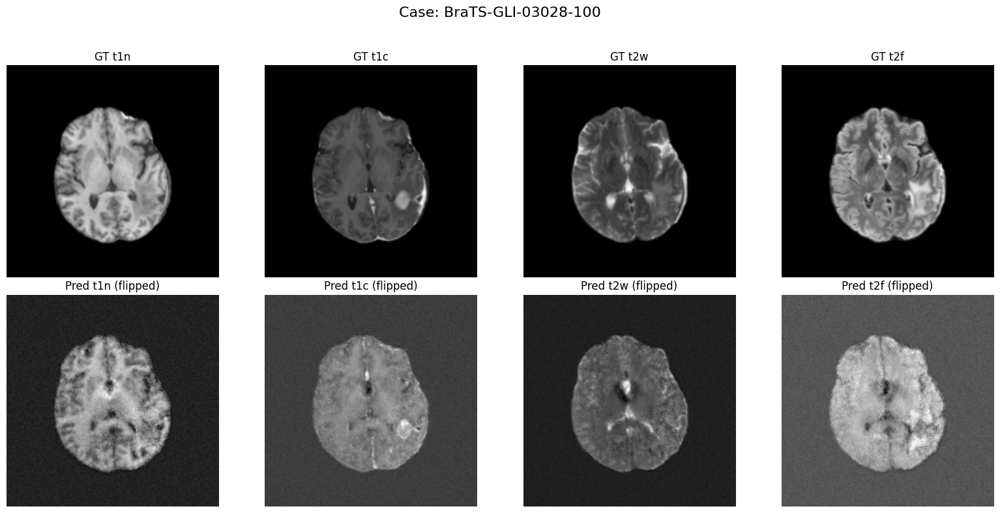

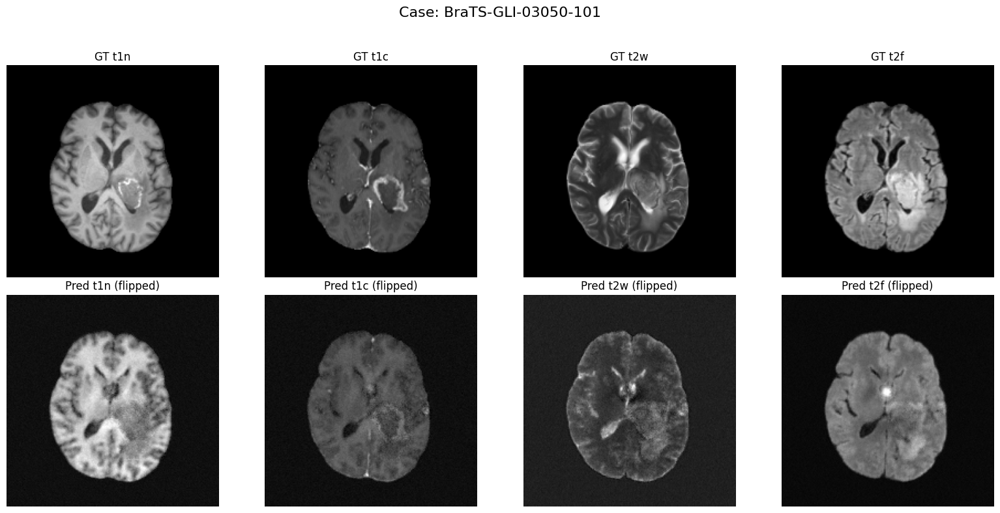

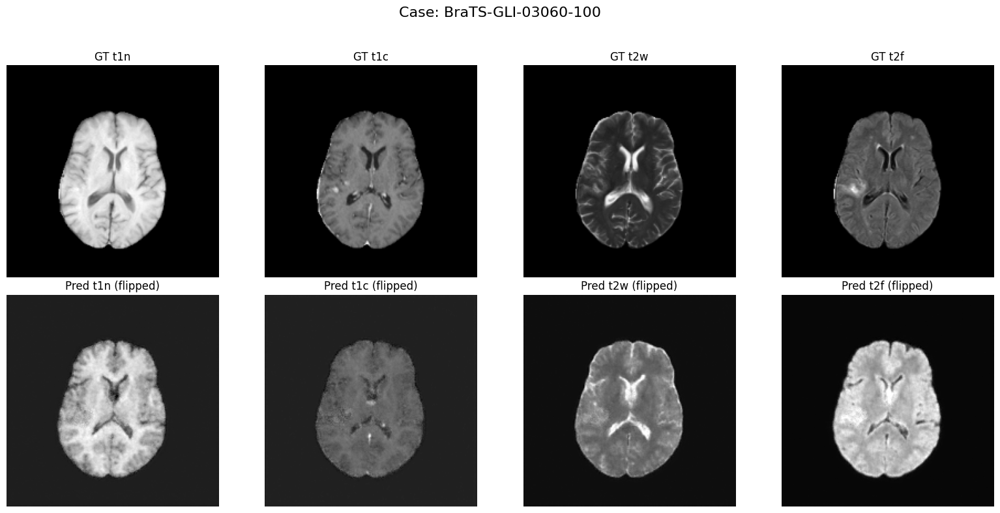

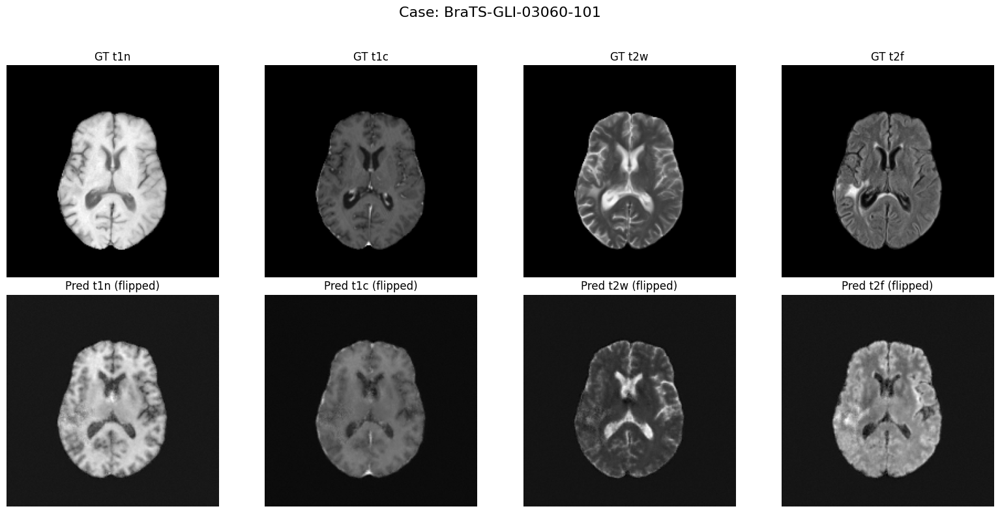

In [10]:
import os
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np

# List of modalities to consider
modalities = ["t1n", "t1c", "t2w", "t2f"]

def get_files(folder, modalities):
    """
    Retrieve nii.gz files grouped by case ID and modality.
    Works for a flat folder or for folders that contain modality subfolders.
    """
    files = {}
    items = os.listdir(folder)
    has_subfolders = any(os.path.isdir(os.path.join(folder, item)) for item in items)
    
    if has_subfolders:
        # Assume each modality has its own subfolder (e.g., folder/t1n, folder/t1c, etc.)
        for modality in modalities:
            modality_folder = os.path.join(folder, modality)
            if os.path.isdir(modality_folder):
                for filename in os.listdir(modality_folder):
                    if filename.endswith(".nii.gz"):
                        # Assume case ID is the first token before an underscore
                        case_id = filename.split('_')[0]
                        if case_id:
                            files.setdefault(case_id, {})[modality] = os.path.join(modality_folder, filename)
    else:
        # Flat folder: all files in one directory.
        for filename in os.listdir(folder):
            if filename.endswith(".nii.gz"):
                parts = filename.split('_')
                if len(parts) < 2:
                    continue
                case_id = parts[0]  # e.g., "BraTS-GLI-00027-101"
                modality = parts[-1].replace(".nii.gz", "")
                if modality in modalities:
                    files.setdefault(case_id, {})[modality] = os.path.join(folder, filename)
    return files

def get_middle_slice(volume_path):
    """
    Load the nii.gz volume and return a mid-slice along the third axis.
    """
    img = nib.load(volume_path)
    data = img.get_fdata()
    if data.ndim < 3:
        return data
    slice_index = data.shape[2] // 2
    return data[:, :, slice_index]

# Set your folder paths here
val_gt_folder = "val_gt"
val_pred_folder = "val_pred"

# Get the files from each folder
gt_cases = get_files(val_gt_folder, modalities)
pred_cases = get_files(val_pred_folder, modalities)
common_cases = set(gt_cases.keys()) & set(pred_cases.keys())

# Loop over each case and display the four modalities with matplotlib
for case_id in sorted(common_cases):
    # Create a figure with 2 rows (GT and Pred) and as many columns as modalities
    fig, axs = plt.subplots(2, len(modalities), figsize=(4 * len(modalities), 8))
    fig.suptitle(f"Case: {case_id}", fontsize=16)
    
    for i, modality in enumerate(modalities):
        # Ground Truth
        gt_file = gt_cases[case_id].get(modality)
        if gt_file:
            gt_slice = get_middle_slice(gt_file)
            axs[0, i].imshow(gt_slice.T, cmap="gray", origin="lower")
            axs[0, i].set_title(f"GT {modality}")
        else:
            axs[0, i].text(0.5, 0.5, "MISSING", ha="center", va="center")
        axs[0, i].axis("off")
        
        # Predicted (flipped horizontally)
        pred_file = pred_cases[case_id].get(modality)
        if pred_file:
            pred_slice = get_middle_slice(pred_file)
            # Flip the predicted slice horizontally
            pred_slice = np.flipud(pred_slice)
            axs[1, i].imshow(pred_slice.T, cmap="gray", origin="lower")
            axs[1, i].set_title(f"Pred {modality} (flipped)")
        else:
            axs[1, i].text(0.5, 0.5, "MISSING", ha="center", va="center")
        axs[1, i].axis("off")
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

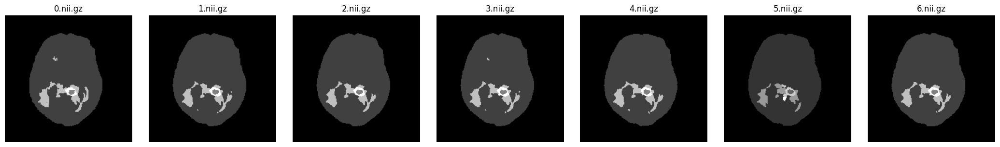

In [11]:
import os
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np

# Folder containing the NIfTI files (labeled 0.nii.gz to 6.nii.gz)
folder_path = 'seg_masks'

# Create a row of 7 subplots (for files 0-6)
fig, axes = plt.subplots(1, 7, figsize=(21, 3))

for i in range(7):
    file_name = f"{i}.nii.gz"
    file_path = os.path.join(folder_path, file_name)
    
    # Load the NIfTI file
    img = nib.load(file_path)
    data = img.get_fdata()
    
    # Extract the middle slice (along the third dimension here)
    mid_slice = data.shape[2] // 2
    slice_data = data[:, :, mid_slice]
    
    # Display the slice
    axes[i].imshow(slice_data.T, cmap='gray', origin='lower')
    axes[i].set_title(file_name)
    axes[i].axis('off')

plt.tight_layout()
plt.show()